# Imports para o Projeto

In [116]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pandas import DataFrame as df
from scipy.stats import zscore
import seaborn as sns
import re

from ydata_profiling import ProfileReport
import sweetviz as sv

# Abrindo e limpando o CSV

In [117]:
df = pd.read_csv("./data/train.csv", na_values=[' ', '_', '_______'], low_memory=False)
df


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,0x1602,CUS_0xd40,January,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,...,NaN,809.98,26.822620,22 Years and 1 Months,No,49.574949,80.41529543900253,High_spent_Small_value_payments,312.49408867943663,Good
1,0x1603,CUS_0xd40,February,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,31.944960,NaN,No,49.574949,118.28022162236736,Low_spent_Large_value_payments,284.62916249607184,Good
2,0x1604,CUS_0xd40,March,Aaron Maashoh,-500,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,28.609352,22 Years and 3 Months,No,49.574949,81.699521264648,Low_spent_Medium_value_payments,331.2098628537912,Good
3,0x1605,CUS_0xd40,April,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,31.377862,22 Years and 4 Months,No,49.574949,199.4580743910713,Low_spent_Small_value_payments,223.45130972736786,Good
4,0x1606,CUS_0xd40,May,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,...,Good,809.98,24.797347,22 Years and 5 Months,No,49.574949,41.420153086217326,High_spent_Medium_value_payments,341.48923103222177,Good
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,0x25fe9,CUS_0x942c,April,Nicks,25,078-73-5990,Mechanic,39628.99,3359.415833,4,...,NaN,502.38,34.663572,31 Years and 6 Months,No,35.104023,60.97133255718485,High_spent_Large_value_payments,479.86622816574095,Poor
99996,0x25fea,CUS_0x942c,May,Nicks,25,078-73-5990,Mechanic,39628.99,3359.415833,4,...,NaN,502.38,40.565631,31 Years and 7 Months,No,35.104023,54.18595028760385,High_spent_Medium_value_payments,496.651610435322,Poor
99997,0x25feb,CUS_0x942c,June,Nicks,25,078-73-5990,Mechanic,39628.99,3359.415833,4,...,Good,502.38,41.255522,31 Years and 8 Months,No,35.104023,24.02847744864441,High_spent_Large_value_payments,516.8090832742814,Poor
99998,0x25fec,CUS_0x942c,July,Nicks,25,078-73-5990,Mechanic,39628.99,3359.415833,4,...,Good,502.38,33.638208,31 Years and 9 Months,No,35.104023,251.67258219721603,Low_spent_Large_value_payments,319.1649785257098,Standard


In [118]:
# Função para tentar converter valores para numérico ou data
def try_convert(value):
    try:
        return pd.to_numeric(value)
    except ValueError:
        try: 
            return pd.to_datetime(value)
        except ValueError: 
            return value

# Lista das colunas a serem removidas
colunas_remover = ["ID", "Name", "SSN"]

# Remover as colunas do DataFrame original
df = df.drop(columns=colunas_remover)

# Aplicar a conversão de valores
df = df.applymap(try_convert)

/var/folders/nm/hxs4p4910kdbl0j_j_d85hsc0000gn/T/ipykernel_2142/1017453626.py:18: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df = df.applymap(try_convert)


# Mostrando o data frame com as colunas "ID", "Name", "SSN" removidas

In [119]:
df

,Customer_ID,Month,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,CUS_0xd40,January,23,Scientist,19114.12,1824.843333,3,4,3,4,...,NaN,809.98,26.822620,22 Years and 1 Months,No,49.574949,80.415295,High_spent_Small_value_payments,312.494089,Good
1,CUS_0xd40,February,23,Scientist,19114.12,NaN,3,4,3,4,...,Good,809.98,31.944960,NaN,No,49.574949,118.280222,Low_spent_Large_value_payments,284.629162,Good
2,CUS_0xd40,March,-500,Scientist,19114.12,NaN,3,4,3,4,...,Good,809.98,28.609352,22 Years and 3 Months,No,49.574949,81.699521,Low_spent_Medium_value_payments,331.209863,Good
3,CUS_0xd40,April,23,Scientist,19114.12,NaN,3,4,3,4,...,Good,809.98,31.377862,22 Years and 4 Months,No,49.574949,199.458074,Low_spent_Small_value_payments,223.45131,Good
4,CUS_0xd40,May,23,Scientist,19114.12,1824.843333,3,4,3,4,...,Good,809.98,24.797347,22 Years and 5 Months,No,49.574949,41.420153,High_spent_Medium_value_payments,341.489231,Good
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,CUS_0x942c,April,25,Mechanic,39628.99,3359.415833,4,6,7,2,...,NaN,502.38,34.663572,31 Years and 6 Months,No,35.104023,60.971333,High_spent_Large_value_payments,479.866228,Poor
99996,CUS_0x942c,May,25,Mechanic,39628.99,3359.415833,4,6,7,2,...,NaN,502.38,40.565631,31 Years and 7 Months,No,35.104023,54.18595,High_spent_Medium_value_payments,496.65161,Poor
99997,CUS_0x942c,June,25,Mechanic,39628.99,3359.415833,4,6,5729,2,...,Good,502.38,41.255522,31 Years and 8 Months,No,35.104023,24.028477,High_spent_Large_value_payments,516.809083,Poor
99998,CUS_0x942c,July,25,Mechanic,39628.99,3359.415833,4,6,7,2,...,Good,502.38,33.638208,31 Years and 9 Months,No,35.104023,251.672582,Low_spent_Large_value_payments,319.164979,Standard


# Mostrando os tipos das colunas

In [120]:
df.dtypes

Customer_ID                  object
Month                        object
Age                          object
Occupation                   object
Annual_Income                object
Monthly_Inhand_Salary       float64
Num_Bank_Accounts             int64
Num_Credit_Card               int64
Interest_Rate                 int64
Num_of_Loan                  object
Type_of_Loan                 object
Delay_from_due_date           int64
Num_of_Delayed_Payment       object
Changed_Credit_Limit        float64
Num_Credit_Inquiries        float64
Credit_Mix                   object
Outstanding_Debt             object
Credit_Utilization_Ratio    float64
Credit_History_Age           object
Payment_of_Min_Amount        object
Total_EMI_per_month         float64
Amount_invested_monthly      object
Payment_Behaviour            object
Monthly_Balance              object
Credit_Score                 object
dtype: object

# Convertendo as colunas que são dados númericos porém estão como object em Int64 or Float64

In [121]:
colunas_numericas = ['Age', 'Annual_Income', 'Num_of_Loan', 'Delay_from_due_date', 
                     'Num_of_Delayed_Payment', 'Outstanding_Debt', 'Amount_invested_monthly', 'Monthly_Balance']

for coluna in colunas_numericas:
    df[coluna] = pd.to_numeric(df[coluna], errors='coerce')

In [122]:
# Substituir valores não finitos por -1
df['Age'].fillna(-1, inplace=True)

# Converter a coluna "Age" para int
df['Age'] = df['Age'].astype(int)

/var/folders/nm/hxs4p4910kdbl0j_j_d85hsc0000gn/T/ipykernel_2142/3427050158.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['Age'].fillna(-1, inplace=True)


# Mostrando os tipos das colunas após a conversão para verificar se foram bem sucedidas

In [123]:
print(df.dtypes)

Customer_ID                  object
Month                        object
Age                           int64
Occupation                   object
Annual_Income               float64
Monthly_Inhand_Salary       float64
Num_Bank_Accounts             int64
Num_Credit_Card               int64
Interest_Rate                 int64
Num_of_Loan                 float64
Type_of_Loan                 object
Delay_from_due_date           int64
Num_of_Delayed_Payment      float64
Changed_Credit_Limit        float64
Num_Credit_Inquiries        float64
Credit_Mix                   object
Outstanding_Debt            float64
Credit_Utilization_Ratio    float64
Credit_History_Age           object
Payment_of_Min_Amount        object
Total_EMI_per_month         float64
Amount_invested_monthly     float64
Payment_Behaviour            object
Monthly_Balance             float64
Credit_Score                 object
dtype: object


# Mostrando data frame após a conversão do tipo para comparação com o data set após implementação dos dados faltantes

In [124]:
df

,Customer_ID,Month,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,CUS_0xd40,January,23,Scientist,19114.12,1824.843333,3,4,3,4.0,...,NaN,809.98,26.822620,22 Years and 1 Months,No,49.574949,80.415295,High_spent_Small_value_payments,312.494089,Good
1,CUS_0xd40,February,23,Scientist,19114.12,NaN,3,4,3,4.0,...,Good,809.98,31.944960,NaN,No,49.574949,118.280222,Low_spent_Large_value_payments,284.629162,Good
2,CUS_0xd40,March,-500,Scientist,19114.12,NaN,3,4,3,4.0,...,Good,809.98,28.609352,22 Years and 3 Months,No,49.574949,81.699521,Low_spent_Medium_value_payments,331.209863,Good
3,CUS_0xd40,April,23,Scientist,19114.12,NaN,3,4,3,4.0,...,Good,809.98,31.377862,22 Years and 4 Months,No,49.574949,199.458074,Low_spent_Small_value_payments,223.451310,Good
4,CUS_0xd40,May,23,Scientist,19114.12,1824.843333,3,4,3,4.0,...,Good,809.98,24.797347,22 Years and 5 Months,No,49.574949,41.420153,High_spent_Medium_value_payments,341.489231,Good
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,CUS_0x942c,April,25,Mechanic,39628.99,3359.415833,4,6,7,2.0,...,NaN,502.38,34.663572,31 Years and 6 Months,No,35.104023,60.971333,High_spent_Large_value_payments,479.866228,Poor
99996,CUS_0x942c,May,25,Mechanic,39628.99,3359.415833,4,6,7,2.0,...,NaN,502.38,40.565631,31 Years and 7 Months,No,35.104023,54.185950,High_spent_Medium_value_payments,496.651610,Poor
99997,CUS_0x942c,June,25,Mechanic,39628.99,3359.415833,4,6,5729,2.0,...,Good,502.38,41.255522,31 Years and 8 Months,No,35.104023,24.028477,High_spent_Large_value_payments,516.809083,Poor
99998,CUS_0x942c,July,25,Mechanic,39628.99,3359.415833,4,6,7,2.0,...,Good,502.38,33.638208,31 Years and 9 Months,No,35.104023,251.672582,Low_spent_Large_value_payments,319.164979,Standard


# Implementação dos dados faltantes perante o id do usuário nas colunas "Occupation", "Annual_Income", "Monthly_Inhand_Salary"

In [125]:
df[['Occupation', 'Annual_Income', 'Monthly_Inhand_Salary']] = df.groupby('Customer_ID')[['Occupation', 'Annual_Income', 'Monthly_Inhand_Salary']].ffill()
df

,Customer_ID,Month,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,CUS_0xd40,January,23,Scientist,19114.12,1824.843333,3,4,3,4.0,...,NaN,809.98,26.822620,22 Years and 1 Months,No,49.574949,80.415295,High_spent_Small_value_payments,312.494089,Good
1,CUS_0xd40,February,23,Scientist,19114.12,1824.843333,3,4,3,4.0,...,Good,809.98,31.944960,NaN,No,49.574949,118.280222,Low_spent_Large_value_payments,284.629162,Good
2,CUS_0xd40,March,-500,Scientist,19114.12,1824.843333,3,4,3,4.0,...,Good,809.98,28.609352,22 Years and 3 Months,No,49.574949,81.699521,Low_spent_Medium_value_payments,331.209863,Good
3,CUS_0xd40,April,23,Scientist,19114.12,1824.843333,3,4,3,4.0,...,Good,809.98,31.377862,22 Years and 4 Months,No,49.574949,199.458074,Low_spent_Small_value_payments,223.451310,Good
4,CUS_0xd40,May,23,Scientist,19114.12,1824.843333,3,4,3,4.0,...,Good,809.98,24.797347,22 Years and 5 Months,No,49.574949,41.420153,High_spent_Medium_value_payments,341.489231,Good
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,CUS_0x942c,April,25,Mechanic,39628.99,3359.415833,4,6,7,2.0,...,NaN,502.38,34.663572,31 Years and 6 Months,No,35.104023,60.971333,High_spent_Large_value_payments,479.866228,Poor
99996,CUS_0x942c,May,25,Mechanic,39628.99,3359.415833,4,6,7,2.0,...,NaN,502.38,40.565631,31 Years and 7 Months,No,35.104023,54.185950,High_spent_Medium_value_payments,496.651610,Poor
99997,CUS_0x942c,June,25,Mechanic,39628.99,3359.415833,4,6,5729,2.0,...,Good,502.38,41.255522,31 Years and 8 Months,No,35.104023,24.028477,High_spent_Large_value_payments,516.809083,Poor
99998,CUS_0x942c,July,25,Mechanic,39628.99,3359.415833,4,6,7,2.0,...,Good,502.38,33.638208,31 Years and 9 Months,No,35.104023,251.672582,Low_spent_Large_value_payments,319.164979,Standard


# Verificação e correção dos valores da coluna "Age"

In [126]:
# Verificar e corrigir os valores da coluna 'Age' se forem diferentes dos valores correspondentes para o mesmo usuário
df['Age'] = df.groupby('Customer_ID')['Age'].transform(lambda x: x.mask(x != x.mode()[0], x.mode()[0]))

df


,Customer_ID,Month,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,CUS_0xd40,January,23,Scientist,19114.12,1824.843333,3,4,3,4.0,...,NaN,809.98,26.822620,22 Years and 1 Months,No,49.574949,80.415295,High_spent_Small_value_payments,312.494089,Good
1,CUS_0xd40,February,23,Scientist,19114.12,1824.843333,3,4,3,4.0,...,Good,809.98,31.944960,NaN,No,49.574949,118.280222,Low_spent_Large_value_payments,284.629162,Good
2,CUS_0xd40,March,23,Scientist,19114.12,1824.843333,3,4,3,4.0,...,Good,809.98,28.609352,22 Years and 3 Months,No,49.574949,81.699521,Low_spent_Medium_value_payments,331.209863,Good
3,CUS_0xd40,April,23,Scientist,19114.12,1824.843333,3,4,3,4.0,...,Good,809.98,31.377862,22 Years and 4 Months,No,49.574949,199.458074,Low_spent_Small_value_payments,223.451310,Good
4,CUS_0xd40,May,23,Scientist,19114.12,1824.843333,3,4,3,4.0,...,Good,809.98,24.797347,22 Years and 5 Months,No,49.574949,41.420153,High_spent_Medium_value_payments,341.489231,Good
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,CUS_0x942c,April,25,Mechanic,39628.99,3359.415833,4,6,7,2.0,...,NaN,502.38,34.663572,31 Years and 6 Months,No,35.104023,60.971333,High_spent_Large_value_payments,479.866228,Poor
99996,CUS_0x942c,May,25,Mechanic,39628.99,3359.415833,4,6,7,2.0,...,NaN,502.38,40.565631,31 Years and 7 Months,No,35.104023,54.185950,High_spent_Medium_value_payments,496.651610,Poor
99997,CUS_0x942c,June,25,Mechanic,39628.99,3359.415833,4,6,5729,2.0,...,Good,502.38,41.255522,31 Years and 8 Months,No,35.104023,24.028477,High_spent_Large_value_payments,516.809083,Poor
99998,CUS_0x942c,July,25,Mechanic,39628.99,3359.415833,4,6,7,2.0,...,Good,502.38,33.638208,31 Years and 9 Months,No,35.104023,251.672582,Low_spent_Large_value_payments,319.164979,Standard


# Criando um Dataframe vazio (df-nan), filtrando as linhas do dataframe que contém NaN, copiando-as para um o dataframe vazio

In [127]:
# Criar um DataFrame vazio para armazenar as linhas com NaN
df_nan = pd.DataFrame()

# Filtrar as linhas do DataFrame original que contêm NaN
linhas_com_nan = df[df.isna().any(axis=1)]

# Copiar as linhas filtradas para o novo DataFrame
df_nan = linhas_com_nan.copy()

# Visualizar o novo DataFrame com as linhas contendo NaN
df_nan


,Customer_ID,Month,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,CUS_0xd40,January,23,Scientist,19114.12,1824.843333,3,4,3,4.0,...,NaN,809.98,26.822620,22 Years and 1 Months,No,49.574949,80.415295,High_spent_Small_value_payments,312.494089,Good
1,CUS_0xd40,February,23,Scientist,19114.12,1824.843333,3,4,3,4.0,...,Good,809.98,31.944960,NaN,No,49.574949,118.280222,Low_spent_Large_value_payments,284.629162,Good
2,CUS_0xd40,March,23,Scientist,19114.12,1824.843333,3,4,3,4.0,...,Good,809.98,28.609352,22 Years and 3 Months,No,49.574949,81.699521,Low_spent_Medium_value_payments,331.209863,Good
4,CUS_0xd40,May,23,Scientist,19114.12,1824.843333,3,4,3,4.0,...,Good,809.98,24.797347,22 Years and 5 Months,No,49.574949,41.420153,High_spent_Medium_value_payments,341.489231,Good
6,CUS_0xd40,July,23,Scientist,19114.12,1824.843333,3,4,3,4.0,...,Good,809.98,22.537593,22 Years and 7 Months,No,49.574949,178.344067,Low_spent_Small_value_payments,244.565317,Good
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99993,CUS_0x942c,February,25,Mechanic,39628.99,3359.415833,4,6,7,2.0,...,Good,502.38,29.135447,31 Years and 4 Months,No,58638.000000,180.733095,Low_spent_Medium_value_payments,400.104466,Standard
99994,CUS_0x942c,March,25,Mechanic,39628.99,3359.415833,4,6,7,2.0,...,NaN,502.38,39.323569,31 Years and 5 Months,No,35.104023,140.581403,High_spent_Medium_value_payments,410.256158,Poor
99995,CUS_0x942c,April,25,Mechanic,39628.99,3359.415833,4,6,7,2.0,...,NaN,502.38,34.663572,31 Years and 6 Months,No,35.104023,60.971333,High_spent_Large_value_payments,479.866228,Poor
99996,CUS_0x942c,May,25,Mechanic,39628.99,3359.415833,4,6,7,2.0,...,NaN,502.38,40.565631,31 Years and 7 Months,No,35.104023,54.185950,High_spent_Medium_value_payments,496.651610,Poor


# Criação de um data frame de com a quantidade dados faltantes por usuário com base no data frame original

In [128]:
dados_faltantes_por_usuario = df_nan.groupby('Customer_ID').apply(lambda x: x.isnull().sum())

# Renomear o índice para melhorar a legibilidade
dados_faltantes_por_usuario.index.names = ['Customer_ID']

# Visualizar a quantidade de dados faltantes em cada coluna por usuário
print("\nQuantidade de dados faltantes em cada coluna por usuário:")
dados_faltantes_por_usuario


Quantidade de dados faltantes em cada coluna por usuário:


/var/folders/nm/hxs4p4910kdbl0j_j_d85hsc0000gn/T/ipykernel_2142/2201196198.py:1: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  dados_faltantes_por_usuario = df_nan.groupby('Customer_ID').apply(lambda x: x.isnull().sum())


,Customer_ID,Month,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
Customer_ID,,,,,,,,,,,,,,,,,,,,,
CUS_0x1009,0,0,0,0,0,0,0,0,0,1,...,3,1,0,1,0,0,0,0,0,0
CUS_0x100b,0,0,0,0,0,0,0,0,0,1,...,1,0,0,1,0,0,2,0,0,0
CUS_0x1011,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
CUS_0x1013,0,0,0,0,0,2,0,0,0,0,...,1,0,0,1,0,0,0,0,0,0
CUS_0x1015,0,0,0,0,0,0,0,0,0,0,...,0,1,0,1,0,0,2,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CUS_0xff3,0,0,0,0,0,0,0,0,0,0,...,2,0,0,1,0,0,0,0,0,0
CUS_0xff4,0,0,0,0,0,0,0,0,0,1,...,2,0,0,1,0,0,0,0,0,0
CUS_0xff6,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,2,0,1,0


# Remoção das colunas que não tem dados faltantes do data frame de quantidade de dados faltantes por usuário

In [129]:
dados_faltantes_por_usuario = dados_faltantes_por_usuario.loc[:, (dados_faltantes_por_usuario != 0).any(axis=0)]

# Visualizar a quantidade de dados faltantes em cada coluna por usuário após a remoção das colunas vazias
print("Quantidade de dados faltantes em cada coluna por usuário (após a remoção das colunas vazias):")
dados_faltantes_por_usuario

Quantidade de dados faltantes em cada coluna por usuário (após a remoção das colunas vazias):


,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_of_Loan,Type_of_Loan,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_History_Age,Amount_invested_monthly,Monthly_Balance
Customer_ID,,,,,,,,,,,,,
CUS_0x1009,0,0,0,1,0,0,0,0,3,1,1,0,0
CUS_0x100b,0,0,0,1,8,0,1,0,1,0,1,2,0
CUS_0x1011,0,0,0,0,0,3,0,0,0,0,0,1,0
CUS_0x1013,0,0,2,0,0,1,0,0,1,0,1,0,0
CUS_0x1015,0,0,0,0,8,0,1,0,0,1,1,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
CUS_0xff3,0,0,0,0,0,1,0,0,2,0,1,0,0
CUS_0xff4,0,0,0,1,0,1,0,2,2,0,1,0,0
CUS_0xff6,0,0,0,0,0,1,0,1,1,0,0,2,1


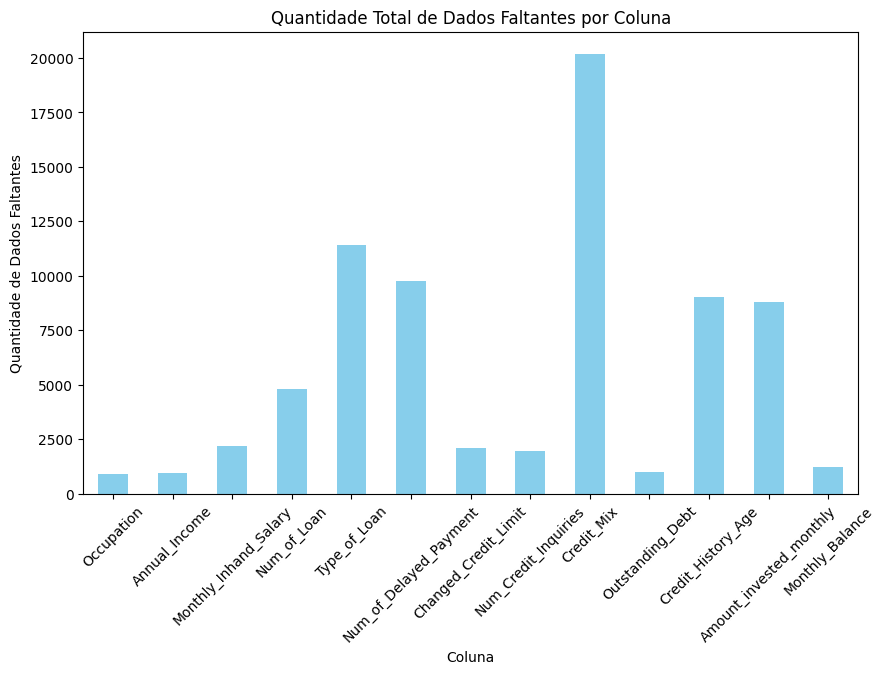

In [130]:
# Calcular a quantidade total de dados faltantes em cada coluna
dados_faltantes_total = dados_faltantes_por_usuario.sum()

# Criar um gráfico de barras para visualizar a quantidade total de dados faltantes por coluna
dados_faltantes_total.plot(kind='bar', figsize=(10, 6), color='skyblue')
plt.title('Quantidade Total de Dados Faltantes por Coluna')
plt.xlabel('Coluna')
plt.ylabel('Quantidade de Dados Faltantes')
plt.xticks(rotation=45)
plt.show()

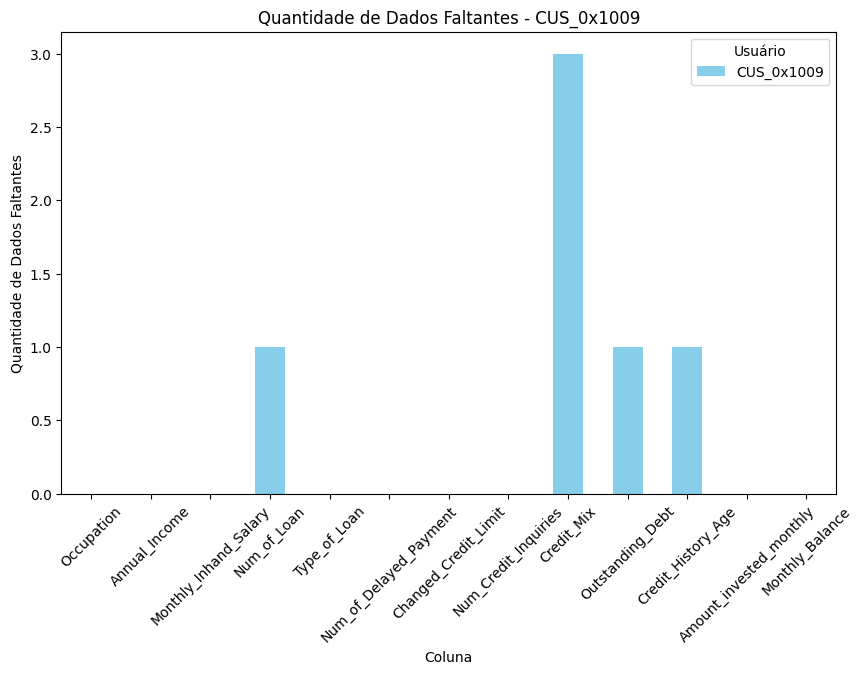

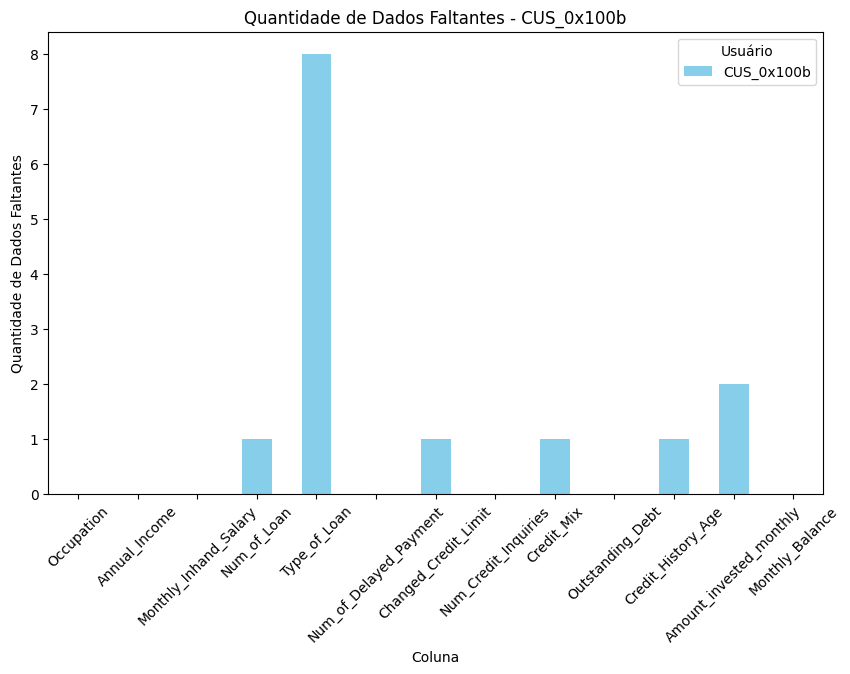

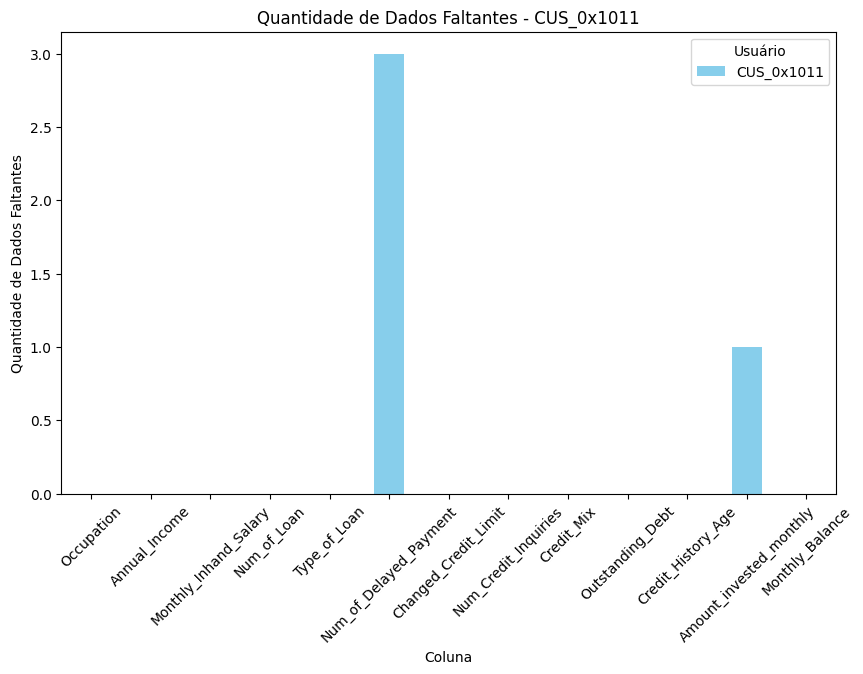

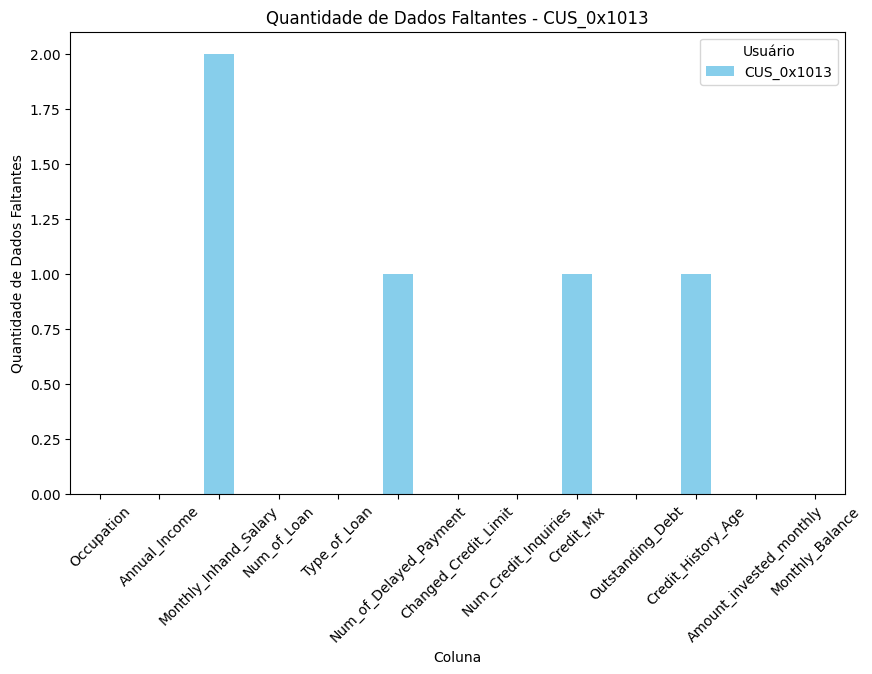

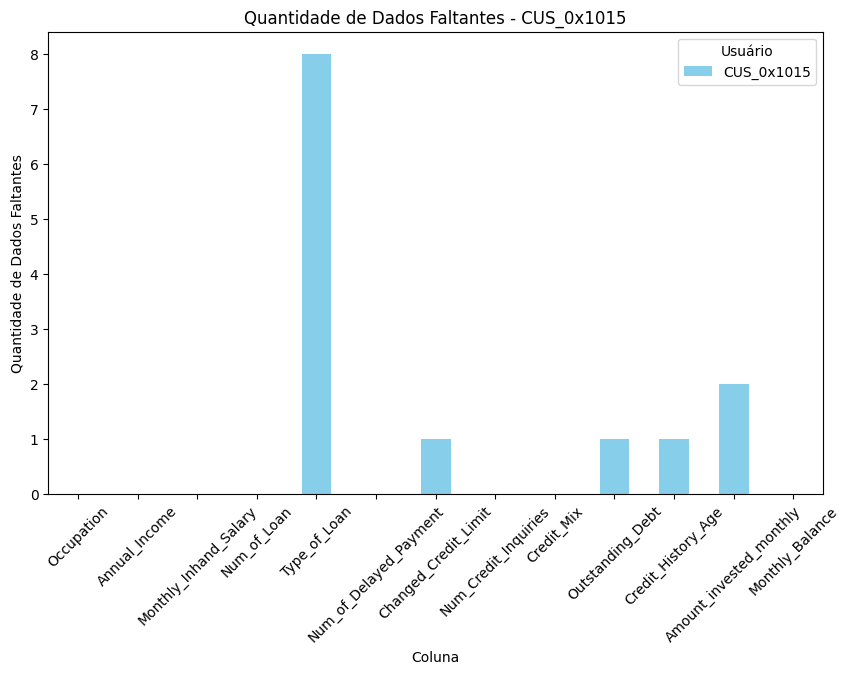

...

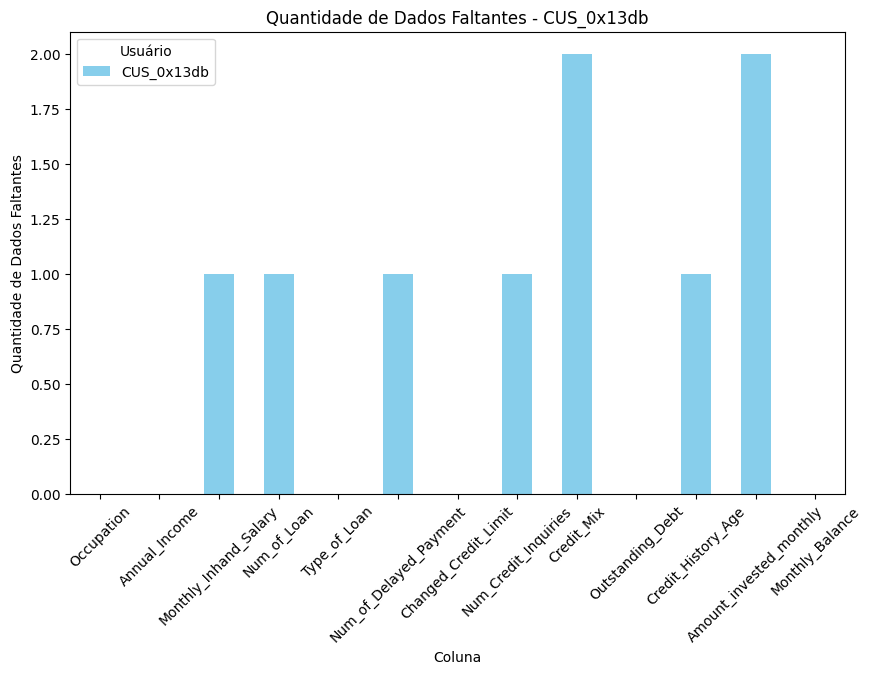

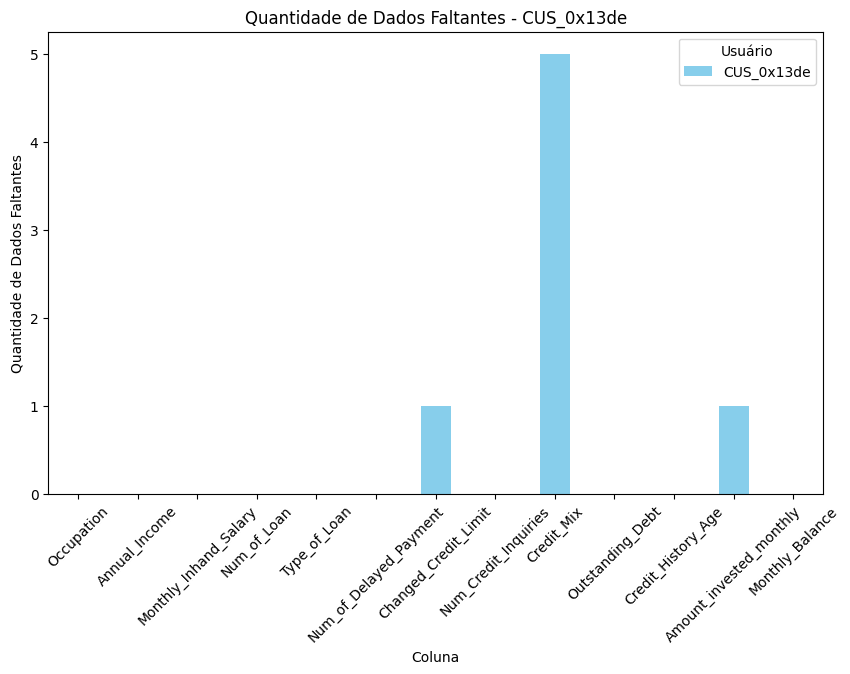

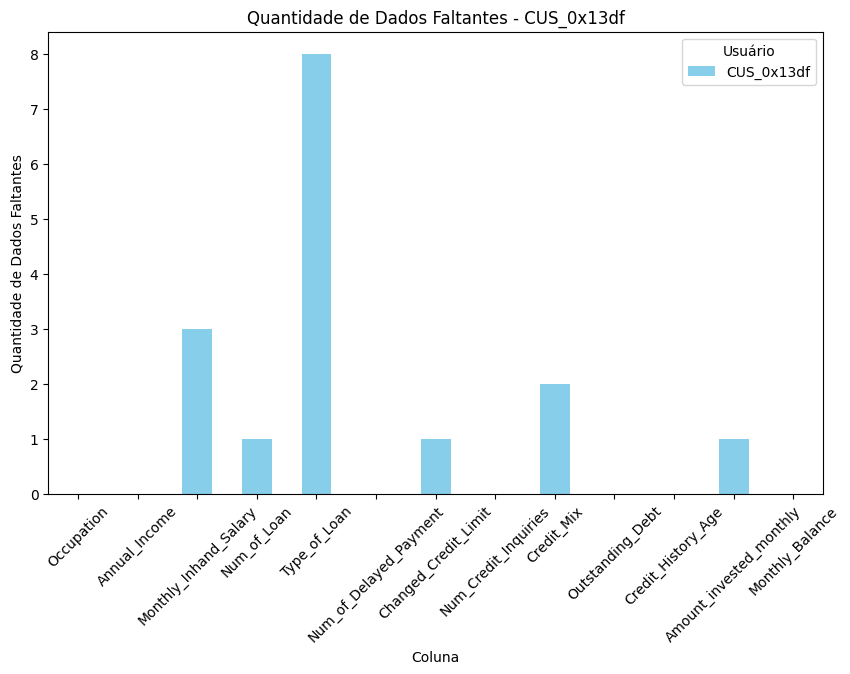

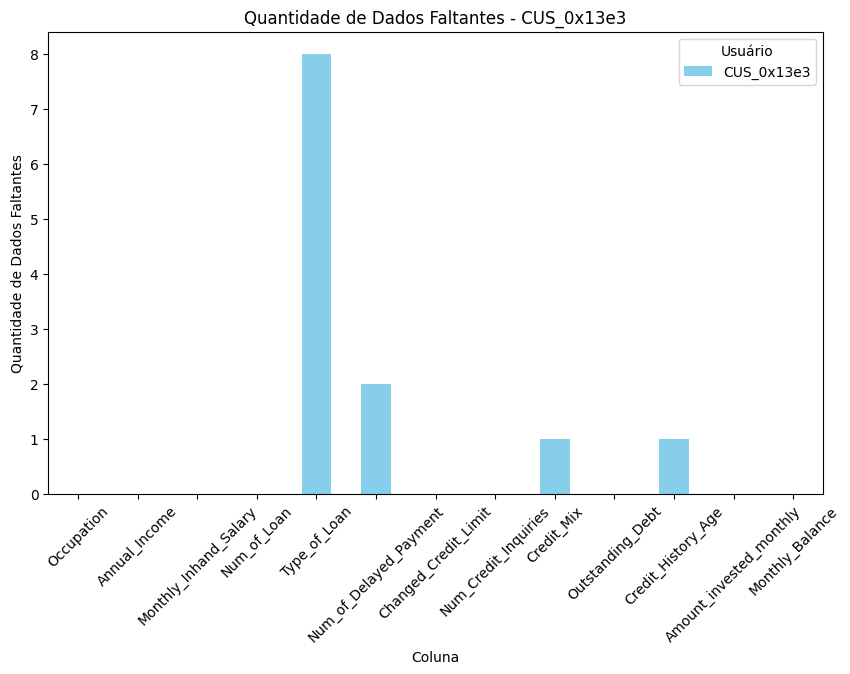

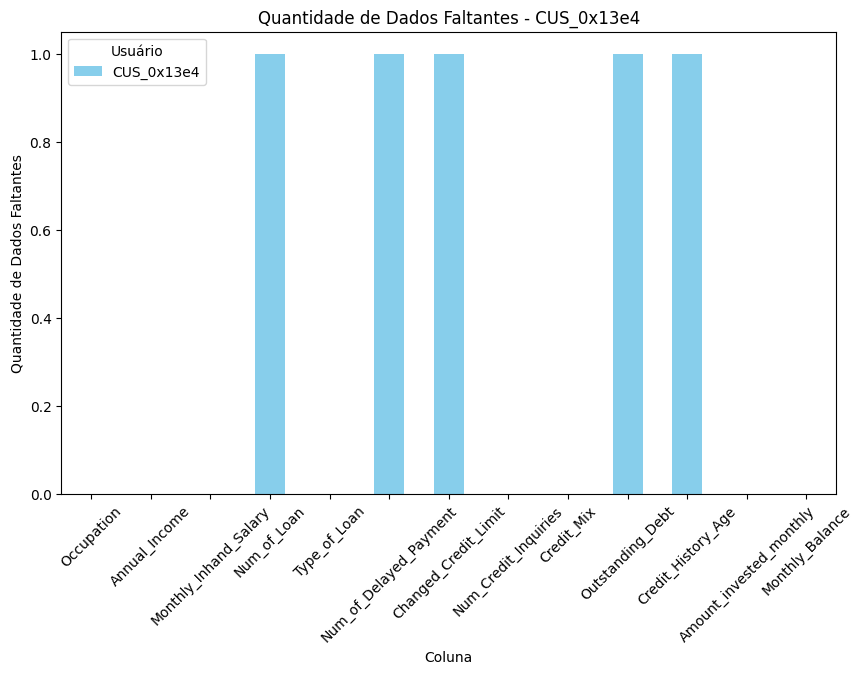

KeyboardInterrupt: 

<Figure size 1000x600 with 0 Axes>

In [131]:
# Transpor o DataFrame para que os usuários se tornem índices
dados_faltantes_por_usuario_T = dados_faltantes_por_usuario.T

# Criar um gráfico de barras para cada coluna
for coluna in dados_faltantes_por_usuario_T.columns:
    plt.figure(figsize=(10, 6))
    dados_faltantes_por_usuario_T[coluna].plot(kind='bar', color='skyblue')
    plt.title(f'Quantidade de Dados Faltantes - {coluna}')
    plt.xlabel('Coluna')
    plt.ylabel('Quantidade de Dados Faltantes')
    plt.xticks(rotation=45)
    plt.legend(title='Usuário')
    plt.show()

# Exportação do data frame de quantidade de dados faltantes por usuário em excel

In [72]:
#dados_faltantes_por_usuario.to_excel('dados_faltantes_por_usuario.xlsx')